In [1]:
import Pkg
using Random
using LinearAlgebra
using Plots
using Distributions
include("functions.jl")
using Pkg

In [2]:
# Définition des paramètres
n_particles = 5
T = 2.0
dt = 0.001
chi = 80.0
L = 1.0

# Initialisation avec des positions aléatoires sur le tore
X0 = rand(n_particles) .* L
Y0 = rand(n_particles) .* L

# Simulation
sim = simulate_particles(n_particles, T, dt, X0, Y0, chi, L)

([0.5647006941557763 0.3856046122101766 … 0.3913375708533854 0.9381229357195908; 0.5812127836299361 0.4674921871232541 … 0.4321703743234534 0.914953970931792; … ; -0.8345204279066881 -0.8432589383133652 … -0.8997850931189004 -0.8650843623158946; -0.922766289743405 -0.9584043128646832 … -0.7825962921336643 -0.7833000457498163], [0.45513306295104117 0.9710305216558048 … 0.7770828814768578 0.551695111246516; 0.43564853160937483 0.8519162734119176 … 0.8237707651299332 0.5258355628330917; … ; 0.5820637867423714 0.5291497104715408 … 0.5281022624118805 0.5196551721443959; 0.4525943049101931 0.5368276501218 … 0.5474858785420482 0.5723412459156143])

┌ Info: Saved animation to /home/syy/Documents/msv/modèle-microscopique/Code-Projet-MSV/particles_simulation.gif
└ @ Plots /home/syy/.julia/packages/Plots/Ec1L1/src/animation.jl:156


Plots.AnimatedGif("/home/syy/Documents/msv/modèle-microscopique/Code-Projet-MSV/particles_simulation.gif")
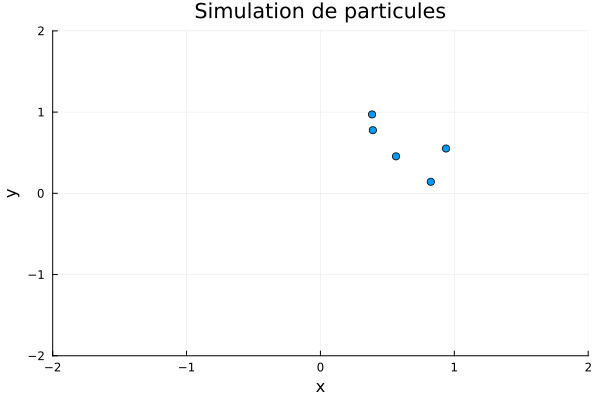

In [4]:
# Paramètres de visualisation
L = 1.0
positions_x, positions_y = sim

# Création de l'animation
anim = @animate for frame_number in 1:size(positions_x, 1)
    scatter(positions_x[frame_number, :], positions_y[frame_number, :], 
            xlim=(-2*L, 2*L), ylim=(-2*L, 2*L), legend=false,
            xlabel="x", ylabel="y", 
            title="Simulation de particules")
end

# Enregistrement en tant que fichier GIF
gif(anim, "particles_simulation.gif", fps=100)

┌ Info: Saved animation to /home/syy/Documents/msv/modèle-microscopique/Code-Projet-MSV/particles_simulation_30fps.gif
└ @ Plots /home/syy/.julia/packages/Plots/Ec1L1/src/animation.jl:156


Plots.AnimatedGif("/home/syy/Documents/msv/modèle-microscopique/Code-Projet-MSV/particles_simulation_30fps.gif")
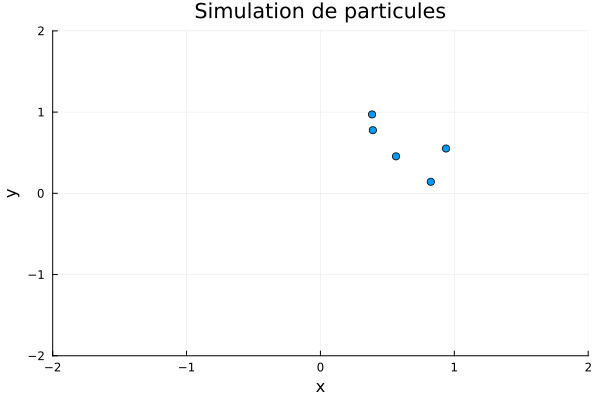

In [7]:
gif(anim, "particles_simulation_30fps.gif", fps=30)

# Simultation processus naissance-mort

In [11]:
# Paramètres de simulation
N0 = 500  # Nombre initial de particules

br = 0.1  # Paramètre br
dr = 0.5 # Paramètre drC
dt = 0.001 # Pas de temps
max_steps = 1000  # Nombre de pas de temps
T=10.0
C= 10
# Initialisation avec des positions entre -2*L et 2*L 
L = 1.0
chi = 80.0
X0 = rand(N0) .* 4*L .- 2*L
Y0= rand(N0) .* 4*L .- 2*L
L=1

# Appel de la fonction pour lancer la simulation
sim=simulate_particles_bd(T, X0, Y0, chi, L, br, dr, C; eps=1e-4, rc=0.1, N_max=2000)

([[-1.301948898520911, 0.4174140464720377, 0.040925783568456886, -1.0065996955630538, -1.6048441614011453, 0.2052972183365558, 1.0631965326476531, -0.4032009562758385, 1.5566352475642895, 1.1068327706047056  …  1.5776536528872223, 1.3414415085161293, 0.6044009939842239, -0.9061609258256236, -0.6092033725524164, 0.5122210761454822, -1.300745102610164, 1.0614267041287486, 0.2099162841193163, -1.4823905657157503], [-1.3165455209344523, 0.41565222489137105, 0.024256125759322036, -0.9927562727510995, -1.6131508935045478, 0.17744295927583859, 1.0682571658678162, -0.41128276883873527, 1.5167145654989465, 1.0945665711433838  …  1.57815962135074, 1.3291726316016033, 0.6220791269614259, -0.9211063461534812, -0.5744699764797269, 0.5185846319983684, -1.345136985359053, 1.1005403991580716, 0.2277993022098692, -1.4786448283664078], [-1.3298051185414925, 0.48434979855949034, 0.013250492332950359, -0.9781492918649849, -1.6634297902077881, 0.1510046800232648, 1.0463980086460085, -0.3853913742505102, 1.

In [13]:
print("naissances: ", sim[3], "\n")
print("morts: ", sim[4], "\n")
print("niter: ", sim[5], "\n")

naissances: 42
morts: 53
niter: 2000


┌ Info: Saved animation to /Users/jeanv./Desktop/3A CS/MSV/projet/particles_simulation.gif
└ @ Plots /Users/jeanv./.julia/packages/Plots/Ec1L1/src/animation.jl:156


Plots.AnimatedGif("/Users/jeanv./Desktop/3A CS/MSV/projet/particles_simulation.gif")
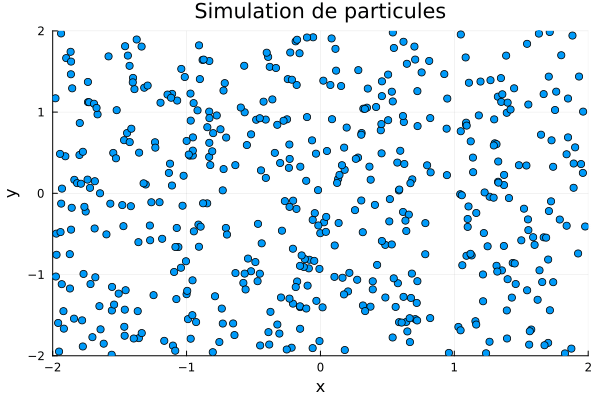

In [14]:

# Paramètres de simulation
positions_x, positions_y = sim

# Création de l'animation
anim = @animate for frame_number in 1:size(positions_x, 1)
    scatter(positions_x[frame_number, :], positions_y[frame_number, :],
            xlim=(-2*L, 2*L), ylim=(-2*L, 2*L), legend=false,
            xlabel="x", ylabel="y", title="Simulation de particules")
end

# Enregistrement en GIF
gif(anim, "particles_simulation.gif", fps=100)


In [ ]:
using Plots

function plot_density_heatmap_gif(positions_x, positions_y, L, n_bins=100)
    n_steps = length(positions_x)
    bins = range(0, L, length=n_bins+1)
    density = zeros(Float64, n_bins, n_bins, n_steps)
    
    # Calcul de la densité toutes les 100 itérations
    for t in 1:n_steps
        if t % 100 != 0
            continue
        end
        for i in 1:length(positions_x[t])
            x = positions_x[t][i]
            y = positions_y[t][i]
            bin_x = clamp(searchsortedfirst(bins, x) - 1, 1, n_bins)
            bin_y = clamp(searchsortedfirst(bins, y) - 1, 1, n_bins)
            density[bin_x, bin_y, t] += 1
        end
    end
    
    # Création de l'animation
    anim = @animate for t in 1:n_steps
        Plots.heatmap(density[:, :, t], xlim=(0, L), ylim=(0, L), 
                xlabel="x", ylabel="y", title="Densité de particules", 
                color=:blues)
    end
    
    # Enregistrement de l'animation sous forme de GIF
    gif(anim, "density_simulation.gif", fps=30)
end

plot_density_heatmap_gif(positions_x, positions_y, L)